In [1]:
import os
import pickle
from glob import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from scipy.stats import pearsonr
from scipy.stats import gaussian_kde
import h5py

In [2]:
subjects_to_be_ignored = [21269692]
subject_sex = 'male'

deconfound_flag = True

# if deconfound_flag == True:
#     import matlab.engine
#     eng = matlab.engine.start_matlab()
#     IDP_file = 'male'
#     if subject_sex == 'female':
#         IDP_file = 'fe' + IDP_file
#     IDP_file += '_test_IDPs.h5'
#     IDP_h5 = h5py.File(IDP_file, 'r')
#     subjects_h5 = IDP_h5['subjects'][()]
    
if deconfound_flag == True:
    IDP_file = 'male_test_IDPs.h5'
    confounds_file = 'male_test_conf12.h5'

#     IDP_file = 'male_testA_IDPs.h5'
#     confounds_file = 'male_testA_conf12.h5'

    confounds = h5py.File(confounds_file, 'r')
    confounds = confounds['conf12'][()]
    
    IDP_h5 = h5py.File(IDP_file, 'r')
    subjects_h5 = IDP_h5['subjects'][()]

In [3]:
df = pd.read_pickle('male_test.pkl')
# df = pd.read_pickle('male_testA.pkl')
# df = pd.read_pickle('male_train.pkl')
dfB = pd.read_pickle('male_testB.pkl')

In [4]:
df.iloc[0].dataframe

,Unnamed: 0,target_age,output_age_1,age_delta_1,loss_1,output_age_2,age_delta_2,loss_2,output_age_3,age_delta_3,loss_3,mean_output_age,mean_age_delta,output_age_decon,age_delta_decon
0,25604371,67.942123,67.507900,-0.434227,0.188553,69.783430,1.841309,3.390418,67.384964,-0.557159,0.310426,68.225431,0.283308,69.078959,1.136836
1,23448390,56.832306,62.910760,6.078453,36.947591,64.360460,7.528152,56.673079,64.519295,7.686989,59.089797,63.930172,7.097866,63.853619,7.021313
2,24979938,52.831164,50.722595,-2.108569,4.446064,52.619720,-0.211444,0.044709,53.288006,0.456841,0.208704,52.210107,-0.621057,49.595733,-3.235432
3,25491324,67.269977,65.640020,-1.629955,2.656753,66.204270,-1.065708,1.135733,66.447070,-0.822910,0.677181,66.097120,-1.172857,66.489791,-0.780186
4,21451642,56.467009,50.530365,-5.936644,35.243744,51.535126,-4.931883,24.323474,50.964710,-5.502299,30.275293,51.010067,-5.456942,48.135840,-8.331169
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4360,25869023,54.817237,53.636505,-1.180732,1.394129,53.514510,-1.302726,1.697096,56.241024,1.423787,2.027168,54.464013,-0.353224,52.337692,-2.479546
4361,25681811,62.667237,64.949100,2.281859,5.206882,65.553510,2.886275,8.330584,65.397430,2.730193,7.453954,65.300013,2.632776,65.520081,2.852844
4362,23068218,75.562900,75.194565,-0.368335,0.135670,76.616380,1.053479,1.109819,72.613785,-2.949115,8.697278,74.808243,-0.754656,77.087190,1.524290
4363,21199766,77.999658,69.663270,-8.336388,69.495373,70.705340,-7.294320,53.207104,71.817310,-6.182351,38.221464,70.728640,-7.271018,72.124204,-5.875454


In [5]:
subjects_h5

array([25604371, 23448390, 24979938, ..., 23068218, 21199766, 24470596])

In [6]:
# def deconfound_inputs(deltas):
    
# #     print(deltas.shape)
# #     print(confounds.shape)
    
# #     print(eng.size(matlab.double(deltas.tolist())))
# #     print(eng.size(matlab.double(confounds.tolist())))
    
# #     print(len(deltas.shape))
    
#     if len(deltas.shape)==1:
#         deltas_deconfounds = eng.NetsUnconfoundWrapper(eng.transpose(matlab.double(deltas.tolist())), 
#                                   matlab.double(confounds.tolist()))
#         deltas_deconfounds = np.asarray(deltas_deconfounds).flatten()
#     else:
#         deltas_deconfounds = eng.NetsUnconfoundWrapper(matlab.double(deltas.tolist()), 
#                                   matlab.double(confounds.tolist()))
#         deltas_deconfounds = np.asarray(deltas_deconfounds)
    
# #     deltas_deconfounds = np.asarray(deltas_deconfounds)
    
#     return deltas_deconfounds

def deconfound_inputs(y):
    
    y = y - y.mean(axis=0)
    if np.sum(np.isnan(y)) == 0:
        beta = np.linalg.pinv(confounds).dot(y)
        beta[np.abs(beta) < 1e-10] = 0
        yd = y - confounds.dot(beta)
        yd = yd - yd.mean()
    else:
        print('ERROR! Encoundered a NaN! Function Needs Updating!')
    
    return yd


def scatter_plot(x, y, xlabel, ylabel, title):
    g = sns.JointGrid()
    sns.scatterplot(x=x, y=y, ax=g.ax_joint) # can set s=10
    sns.kdeplot(x=x, linewidth=2, ax=g.ax_marg_x) 
    sns.kdeplot(y=y, linewidth=2, ax=g.ax_marg_y)

    g.ax_joint.set(xlabel=xlabel, ylabel=ylabel)

    g.ax_joint.plot([np.min(x), np.max(x)], [np.min(x), np.max(x)], linewidth=1.0, color='black', linestyle='solid', label='Equality Line')

    X_mat=np.vstack((np.ones(len(x)), x)).T
    beta_hat = np.linalg.inv(X_mat.T.dot(X_mat)).dot(X_mat.T).dot(y)
    b,w = beta_hat[0],beta_hat[1]
    x2 = np.linspace(np.min(x),np.max(x),num=10)
    y2 = w * x2 + b

    g.ax_joint.plot(x2, y2, 'r--', linewidth=3.0, label='Linear Regression Line')
    g.ax_joint.legend()
    
    pearson_correlation = pearsonr(x,y)[0]

    g.ax_joint.text(np.max(x), np.min(y)+0.05*np.abs(np.min(y2)), 'R='+str(round(pearson_correlation,3)), horizontalalignment='right', fontsize='large')
    print("Reg Slope:", w)

    g.fig.suptitle(title, y=1.05)

    plt.show()

def scatter_plot_heatmap(x, y, xlabel, ylabel, title, equality_line=True, set_scale=False, 
                         deconfound=False, subjects=None):
    
    x = x.to_numpy()
    y = y.to_numpy()
    
    if deconfound==True:
        _, x = align_subjects(subjects, subjects_h5, x, subjects_to_be_ignored)
        _, y = align_subjects(subjects, subjects_h5, y, subjects_to_be_ignored)
        y = deconfound_inputs(y)
        ylabel = ylabel + ' and Deconfounded'
    
    fig = plt.figure(figsize=[7.2, 7.2])
    sns.set_style("darkgrid", {'image.cmap': u'plasma'})
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
    plt.scatter(x,y,c=z,s=50)
    if equality_line == True:
        plt.plot(x, x, ls="-", color = sns.xkcd_rgb['black'], label='Equality Line') #this is just the line of equality
    
    X_mat=np.vstack((np.ones(len(x)), x)).T
    beta_hat = np.linalg.inv(X_mat.T.dot(X_mat)).dot(X_mat.T).dot(y)
    b,w = beta_hat[0],beta_hat[1]
    x2 = np.linspace(np.min(x),np.max(x),num=10)
    y2 = w * x2 + b
    plt.plot(x2,y2,ls='--', color= sns.xkcd_rgb['red'], label='Linear Regression Line')
    
    pearson_correlation = pearsonr(x,y)[0]
#     plt.text(np.max(x), np.min(y)+0.05*np.abs(np.min(y2)), 'R='+str(round(pearson_correlation,3)), horizontalalignment='right', fontsize='large')
    
    if set_scale == True:
        x_min, x_max = np.min(x), np.max(x)
        y_min, y_max = np.min(y), np.max(y)
        c_min, c_max = min(x_min, y_min), max(x_max, y_max)
        plt.xlim([c_min-2, c_max+2])
        plt.ylim([c_min-2, c_max+2])
    
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    
    lbl = 'Pearson R = '+str(round(pearson_correlation,3))
    plt.plot([],[],' ',label=lbl)
    
    plt.title(title)
    plt.legend()
    plt.show()
    
    
def get_corr_plot(array, title, labels, partial_correlation=False, fig_size=None, fix_colorbar_scale=False,
                 title_font_size = None,
                    ticks_font_size = None,
                    legend_font = None,
                  save_fig_title=None,
                 ):
    with sns.axes_style("white"):
        if fig_size == None:
            fig = plt.figure() # can set figsize=(fig_size = 12.8, fig_size)
        else:
            fig = plt.figure(figsize=fig_size)
        ax = fig.add_subplot(111)
        if fix_colorbar_scale == True:
            cax = ax.matshow(array, interpolation='nearest',cmap='viridis', vmin=0, vmax=1)
        else:
            cax = ax.matshow(array, interpolation='nearest',cmap='viridis')
        cbar = fig.colorbar(cax)
        cbar.ax.tick_params(labelsize=ticks_font_size)
        if partial_correlation == False:
            intro = "Correlation (r)"
        else:
            intro = "Partial Correlation"
        plt.title("{} for {}".format(intro, title), fontsize=title_font_size if fig_size != None else 10)
        ax.set_yticks(np.arange(len(labels)), fontsize= ticks_font_size)
        ax.set_yticklabels(labels, fontsize= ticks_font_size)
        ax.xaxis.set_ticks_position("bottom")
        ax.set_xticks(np.arange(len(labels)), fontsize= ticks_font_size)
        ax.set_xticklabels(labels, rotation=90, fontsize= ticks_font_size)

        if save_fig_title is not None:
            plt.savefig(save_fig_title,bbox_inches='tight')
            
        plt.show()

def correlation_plot(df, key, title, partial_correlation= False, fix_colorbar_scale=False,
                    use_B_testset = False, modality_names=None,
                    title_font_size = None,
                    ticks_font_size = None,
                    legend_font = None,
                    figsize = None,
                     save_fig_title=None,
                    ):
    
#     names = df.modality.to_list()
    names = modality_names
    fig_size = figsize
    
    if partial_correlation == False:
        
        computation_matrix = []
        for idx in range(len(df)):
            df1 = df.iloc[idx].dataframe
            subjects1 = df1['Unnamed: 0'].to_numpy()
            data1 = df1[key].to_numpy()
            _, data1 = align_subjects(subjects1, subjects_h5, data1, subjects_to_be_ignored)
            computation_matrix.append(data1.tolist())    
        computation_matrix = np.array(computation_matrix).T

        if deconfound_flag == True:
            computation_matrix = deconfound_inputs(computation_matrix)
            title = title + ' and Deconfounded'
        
        if use_B_testset == True:
            print(computation_matrix.shape)
            _, computation_matrix = train_test_split(computation_matrix, test_size=0.5, random_state=1)
            print(computation_matrix.shape)
        
        corr_df1 = []
        for idx1 in range(computation_matrix.shape[1]):
            data1 = computation_matrix[:, idx1]
            corr_df2 = []
            for idx2 in range(computation_matrix.shape[1]):
                data2 = computation_matrix[:, idx2]
                r, _ = pearsonr(data1, data2)
                corr_df2.append(r)
            corr_df2 = np.array(corr_df2).astype('float32')
            corr_df1.append(corr_df2)
        corr_df1 = np.array(corr_df1).astype('float32')
        get_corr_plot(corr_df1, labels=names, partial_correlation=partial_correlation,
                      title=title, fig_size=fig_size, fix_colorbar_scale=fix_colorbar_scale,
                     title_font_size = title_font_size,
                    ticks_font_size = ticks_font_size,
                    legend_font = legend_font,
                      save_fig_title=save_fig_title
                     )
        
        output_array = corr_df1
        
    else:
        tmp_dct = {}
        if deconfound_flag == True:
            computation_matrix = []
            for idx in range(len(df)):
                df1 = df.iloc[idx].dataframe
                subjects1 = df1['Unnamed: 0'].to_numpy()
                data1 = df1[key].to_numpy()
                _, data1 = align_subjects(subjects1, subjects_h5, data1, subjects_to_be_ignored)
                computation_matrix.append(data1.tolist())    
            computation_matrix = np.array(computation_matrix).T
            computation_matrix = deconfound_inputs(computation_matrix)
            
            if use_B_testset == True:
                print(computation_matrix.shape)
                _, computation_matrix = train_test_split(computation_matrix, test_size=0.5, random_state=1)
                print(computation_matrix.shape)
            
            title = title + ' and Deconfounded'
            for idx in range(computation_matrix.shape[1]):
                tmp_dct[names[idx]] = computation_matrix[:, idx]
            pcorr_df = pd.DataFrame.from_dict(tmp_dct)
            del tmp_dct
        else:
            for idx in range(len(df)):
                tmp_df = df.iloc[idx].dataframe[key]
                tmp_dct[names[idx]] = tmp_df.to_numpy()
            pcorr_df = pd.DataFrame.from_dict(tmp_dct)
            del tmp_dct, tmp_df

        # This implementation comes from https://pingouin-stats.org/index.html
        # Source code here for pcorr: https://github.com/raphaelvallat/pingouin/blob/72e447d539f8cfbd6b9c9c5041e267de748fe124/pingouin/correlation.py

        V = pcorr_df.cov()
        Vi = np.linalg.pinv(V, hermitian=True)
        D = np.diag(np.sqrt(1 / np.diag(Vi)))
        pcor = -1 * (D @ Vi @ D)
        pcor[np.diag_indices_from(pcor)] = 1
        get_corr_plot(pcor, labels=names, partial_correlation=partial_correlation,
                      title=title, fig_size=fig_size, fix_colorbar_scale=fix_colorbar_scale,
                     title_font_size = title_font_size,
                    ticks_font_size = ticks_font_size,
                    legend_font = legend_font,
                      save_fig_title= save_fig_title,
                     )
        
        output_array = pcor
        
    return output_array
        
def kde_plot(x, y, xlabel, ylabel, title):
    plt.figure()
    sns.kdeplot(x, label='Ground Truth')
    sns.kdeplot(y, label= ylabel)
    plt.legend()
    plt.title(title)
    
def align_subjects(subjects_df, subjects_h5, age_delta_decon, subjects_to_be_ignored):
    '''
    Here we make sure that the subjects match between the results and the nIDP/IDP dataframes
    The subjects_df uses slightly older data, and subjects might have left the study since it's generation
    If need be, this will be corrected at a later stage!
    '''
    
    if len(subjects_df) == len(subjects_h5):
        assert (subjects_df == subjects_h5).all()
    else:
        idx_elim = np.where(subjects_df == subjects_to_be_ignored)[0][0]
        subjects_df = np.delete(subjects_df, idx_elim)
        assert (subjects_df == subjects_h5).all()
        age_delta_decon = np.delete(age_delta_decon, idx_elim)
    return subjects_df, age_delta_decon

In [7]:
modality_names = [
    'T1 Nonlinear', 'T1 Linear', 'Jacobian', 'VBM', 'T2 Nonlinear', 'T2 Lessions', 'SWI', 'rsfMRI-0', 'rsfMRI-1',
    'rsfMRI-2', 'rsfMRI-3', 'rsfMRI-4', 'rsfMRI-5', 'rsfMRI-6', 'rsfMRI-7', 'rsfMRI-8', 'rsfMRI-9', 'rsfMRI-10', 
    'rsfMRI-11', 'rsfMRI-12', 'rsfMRI-13', 'rsfMRI-14', 'rsfMRI-15', 'rsfMRI-16', 'rsfMRI-17', 'rsfMRI-18', 'rsfMRI-19',
    'rsfMRI-20', 'rsfMRI-21', 'rsfMRI-22', 'rsfMRI-23', 'rsfMRI-24', 'tfMRI-1', 'tfMRI-2', 'tfMRI-5', 'tfMRI-COPE-1',
    'tfMRI-COPE-2', 'tfMRI-COPE-5', 'Summed Tracts', 'TBSS FA', 'TBSS ICVF', 'TBSS ISOVF', 'TBSS L1', 'TBSS L2',
    'TBSS L3', 'TBSS MD', 'TBSS MO', 'TBSS OD', 'FA', 'ICVF', 'ISOVF', 'L1', 'L2', 'L3', 'MD', 'MO', 'OD'
]




(4365, 57)
(2183, 57)


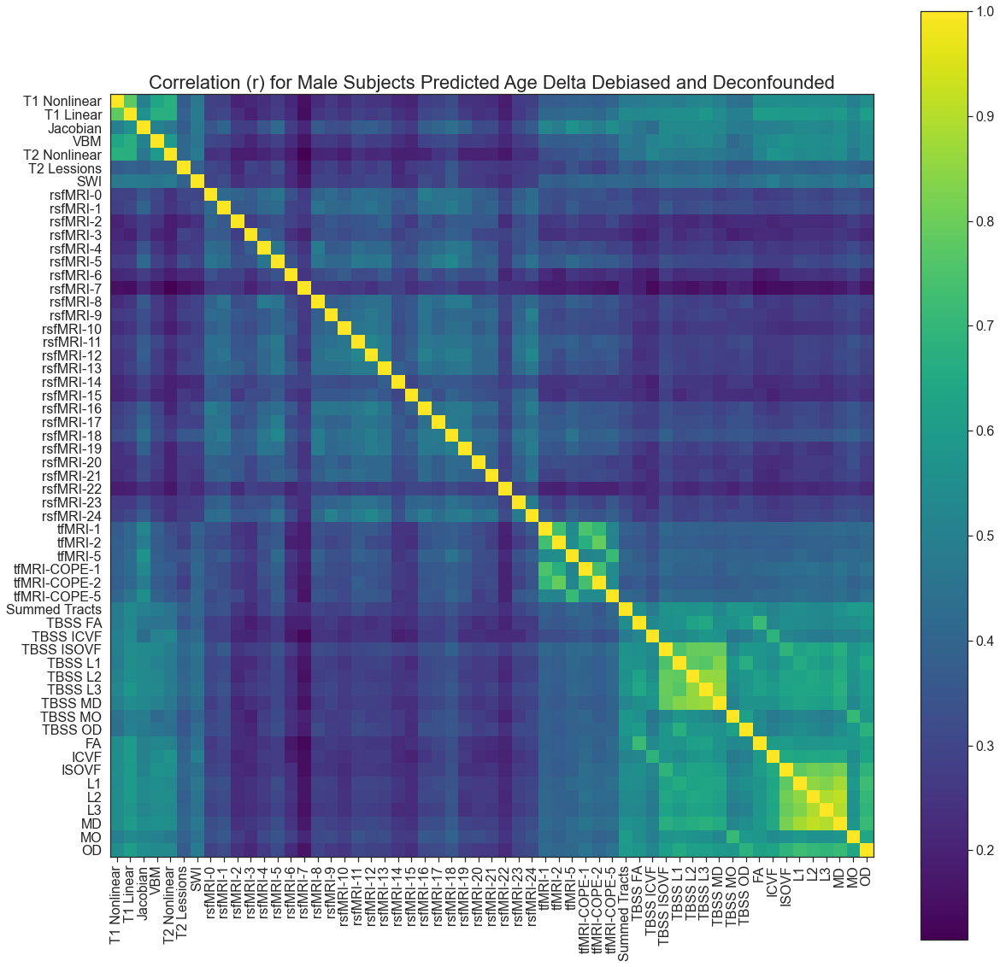

In [14]:
from sklearn.model_selection import train_test_split

title_font_size=22
ticks_font_size=16
legend_font = 18
figsize=(20, 20)

# correlation_plot(df, key='mean_output_age', title='Mean Output Age', fig_size=20)
# correlation_plot(df, key='mean_age_delta', title='Mean Age Delta', fig_size=20)
# correlation_plot(df, key='output_age_decon', title='Output Age Deconfounded', fig_size=20)
corr_df = correlation_plot(df, key='age_delta_decon', title='Male Subjects Predicted Age Delta Debiased', 
                 partial_correlation=False, use_B_testset= True, modality_names=modality_names,
#                            fix_colorbar_scale=True,
                           title_font_size=title_font_size,
                            ticks_font_size=ticks_font_size,
                            legend_font = legend_font,
                            figsize=figsize,
                            save_fig_title='Male_Correlation_Matrix.png'
                          )
# correlation_plot(df, key='age_delta_decon', title='Age Delta Deconfounded', fig_size=20, 
#                  partial_correlation=False, fix_colorbar_scale=True)

In [25]:
from scipy.io import savemat
correlation_matrix_debiased_deconfounded = {
    'correlation_matrix_debiased_deconfounded' : corr_df,
    'labels': df.modality.to_list(),
    'label' : 'correlation_matrix_debiased_deconfounded'
}

save_name = 'ICA/correlation_matrix_debiased_deconfounded.mat'
# save_name = 'ICA/correlation_matrix_debiased_deconfounded_testA.mat'

savemat(save_name, correlation_matrix_debiased_deconfounded)

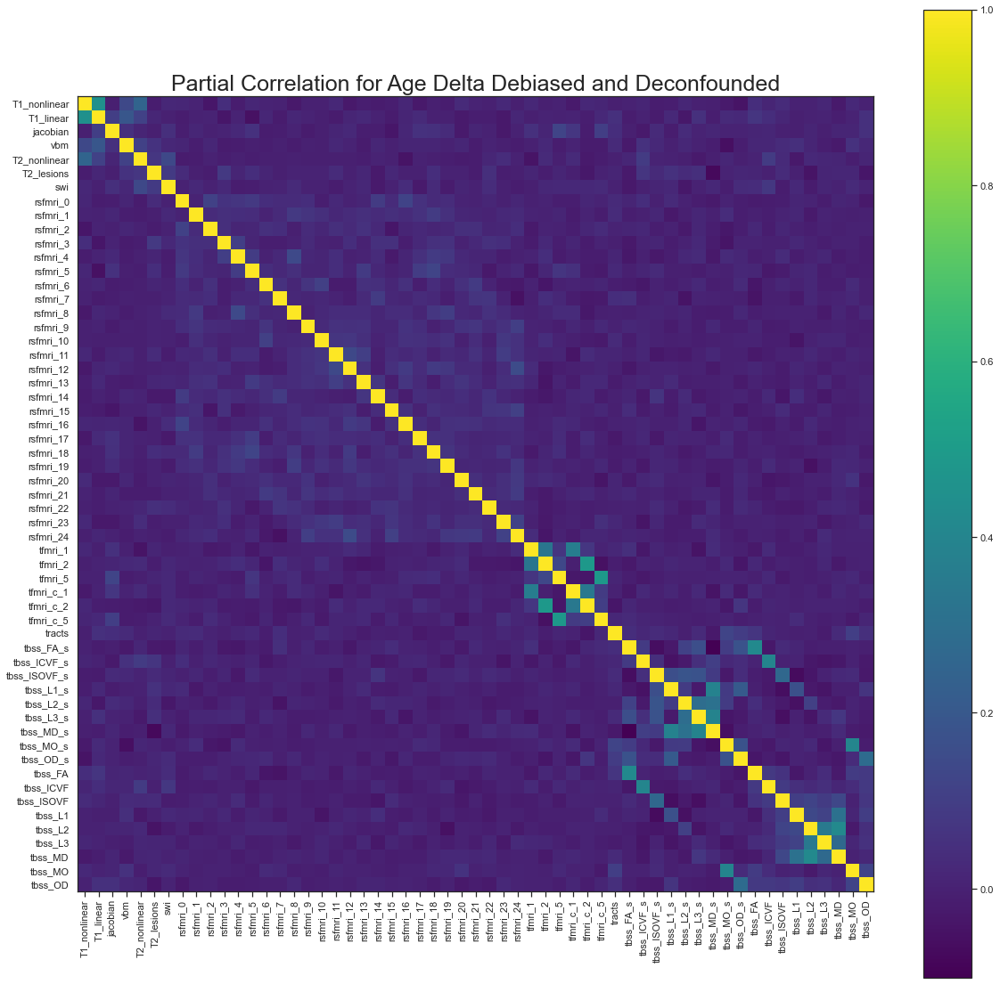

In [9]:
_ = correlation_plot(df, key='age_delta_decon', title='Age Delta Debiased', 
                 partial_correlation=True, fig_size=20)
# correlation_plot(df, key='age_delta_decon', title='Age Delta Deconfounded', fig_size=20, 
#                  partial_correlation=True, fix_colorbar_scale=True)

(4365, 57)
(2183, 57)


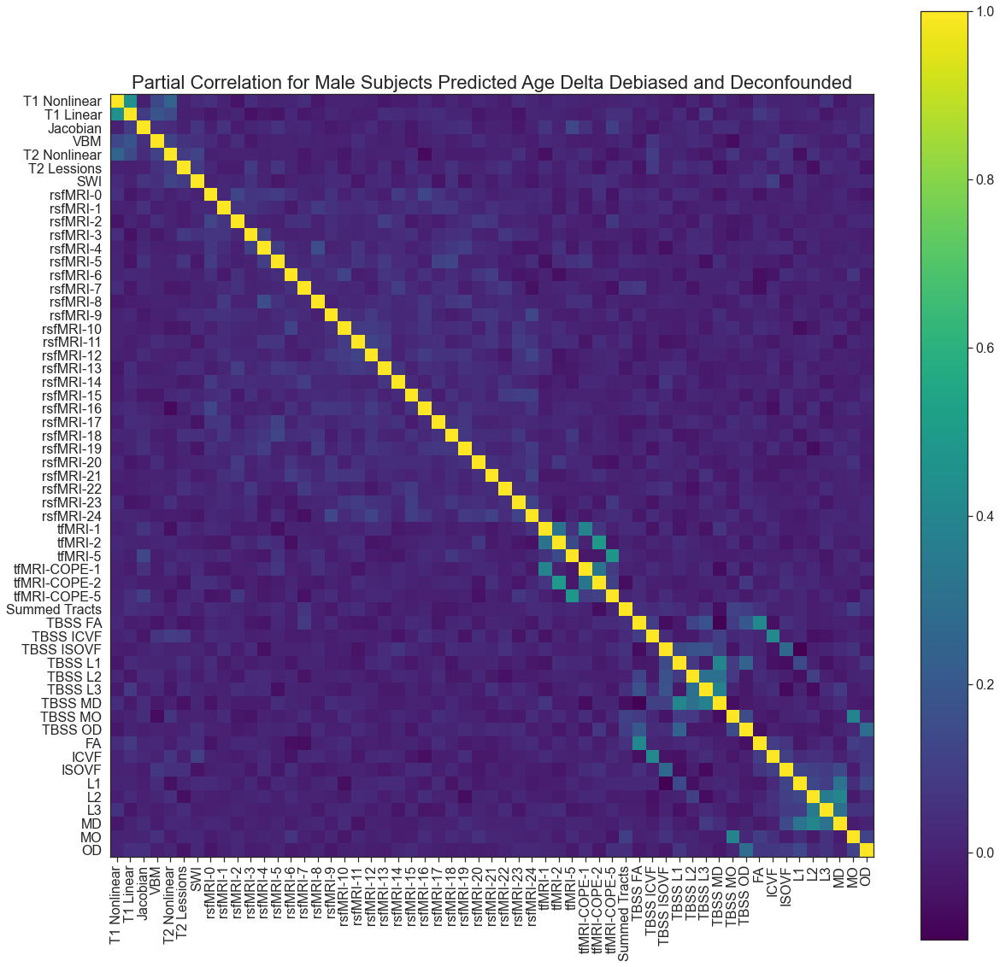

In [15]:
from sklearn.model_selection import train_test_split

title_font_size=22
ticks_font_size=16
legend_font = 18
figsize=(20, 20)

# correlation_plot(df, key='mean_output_age', title='Mean Output Age', fig_size=20)
# correlation_plot(df, key='mean_age_delta', title='Mean Age Delta', fig_size=20)
# correlation_plot(df, key='output_age_decon', title='Output Age Deconfounded', fig_size=20)
corr_df = correlation_plot(df, key='age_delta_decon', title='Male Subjects Predicted Age Delta Debiased', 
                 partial_correlation=True, use_B_testset= True, modality_names=modality_names,
#                            fix_colorbar_scale=True,
                           title_font_size=title_font_size,
                            ticks_font_size=ticks_font_size,
                            legend_font = legend_font,
                            figsize=figsize,
                            save_fig_title='Male_PartialCorrelation_Matrix.png'
                          )
# correlation_plot(df, key='age_delta_decon', title='Age Delta Deconfounded', fig_size=20, 
#                  partial_correlation=False, fix_colorbar_scale=True)

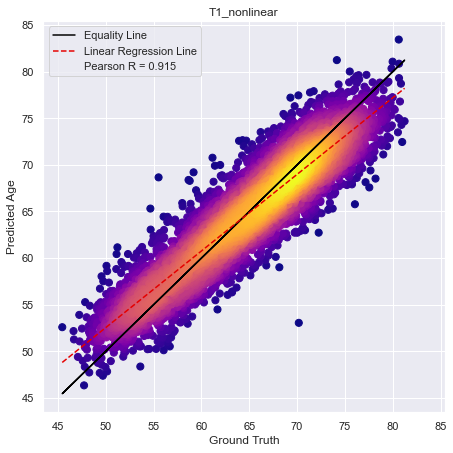

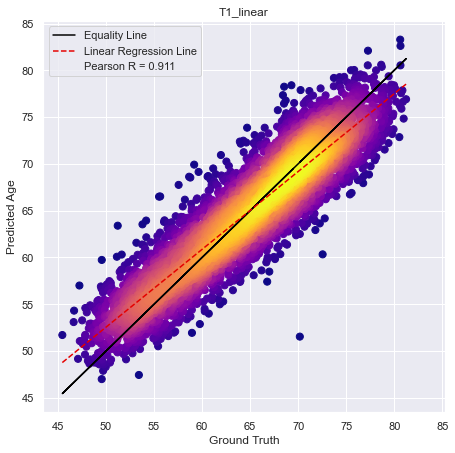

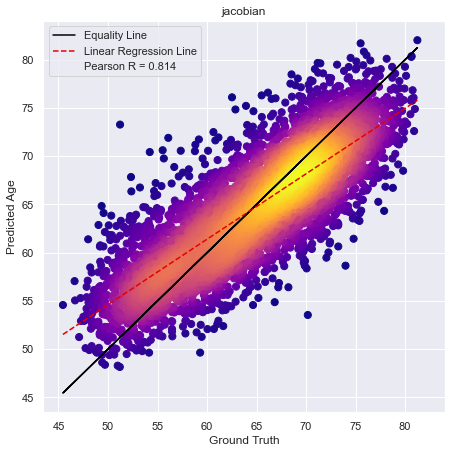

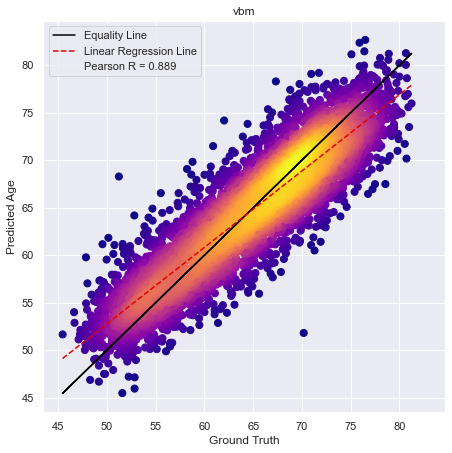

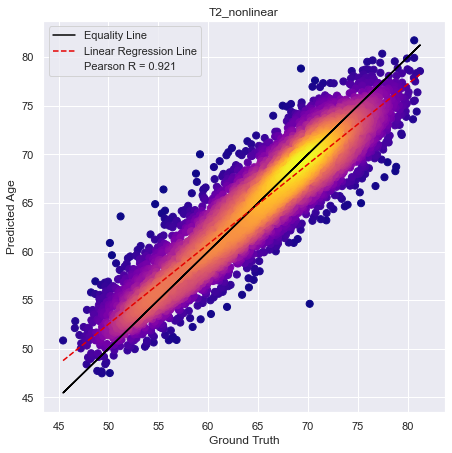

...

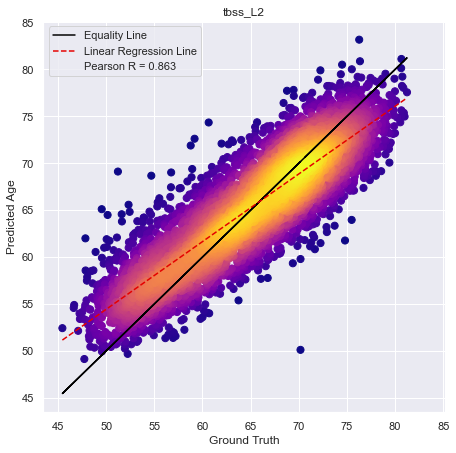

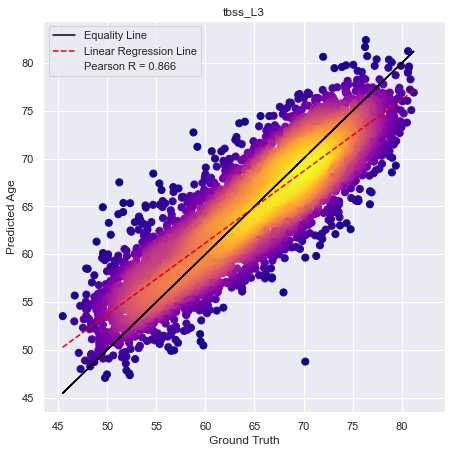

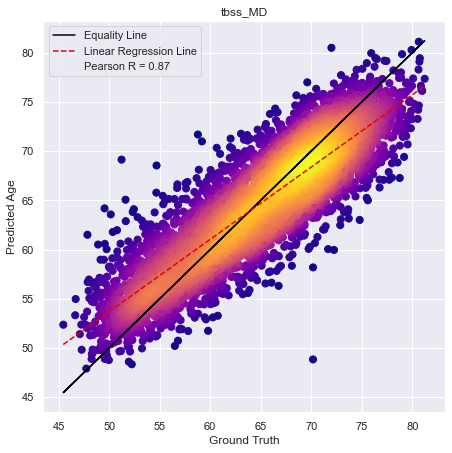

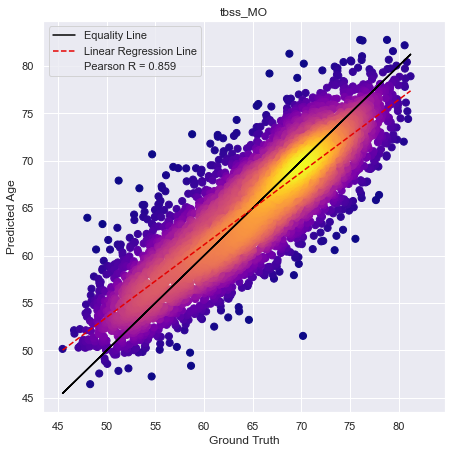

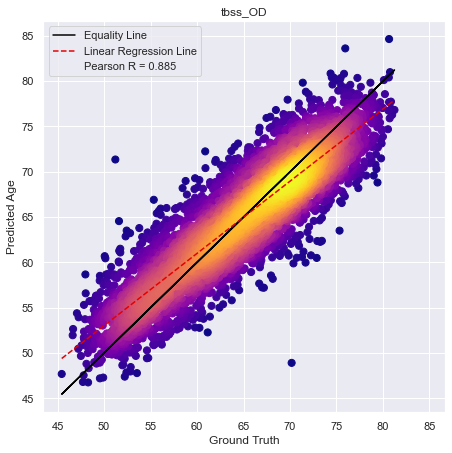

In [10]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.mean_output_age, xlabel='Ground Truth', 
                               ylabel='Predicted Age', title=name_mod, set_scale=True,
                              deconfound=False, subjects=df_mod['Unnamed: 0'].to_numpy())

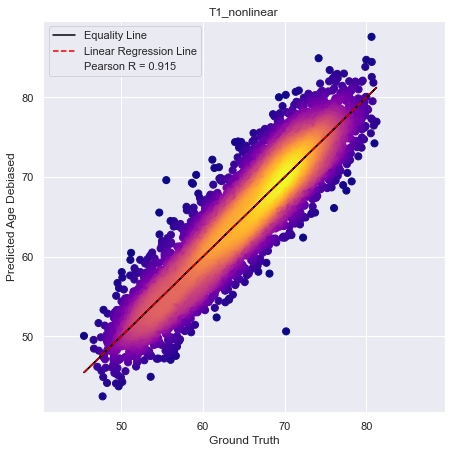

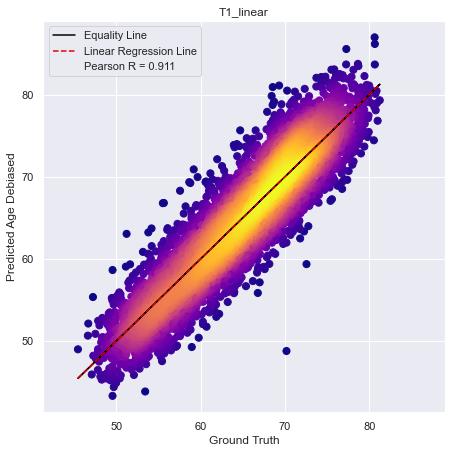

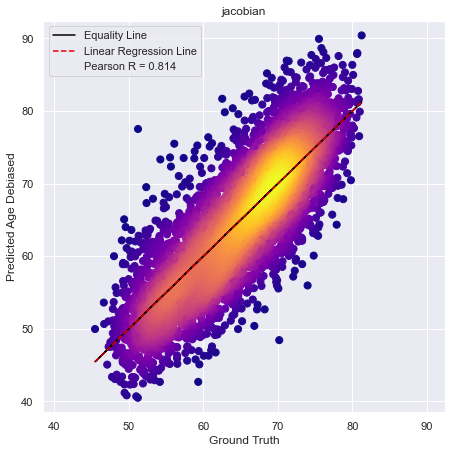

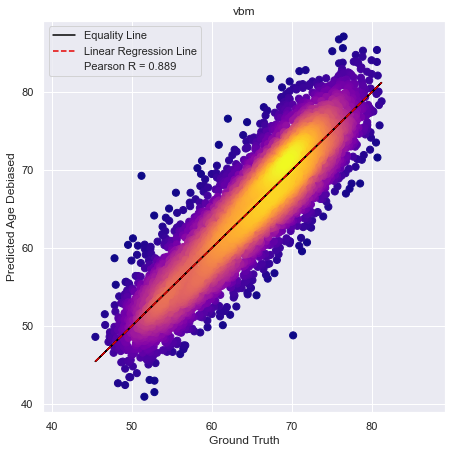

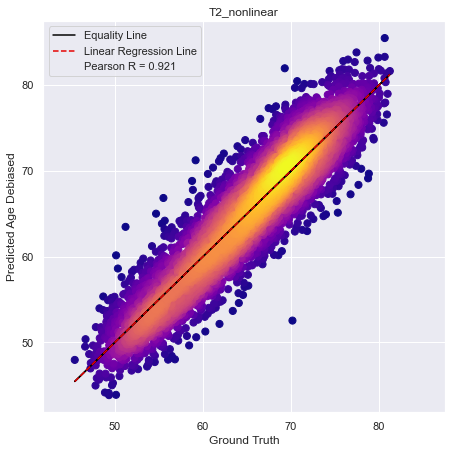

...

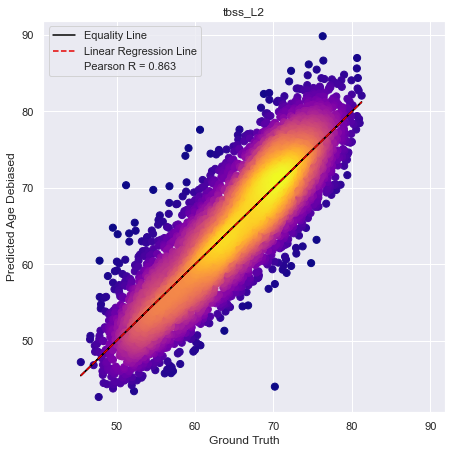

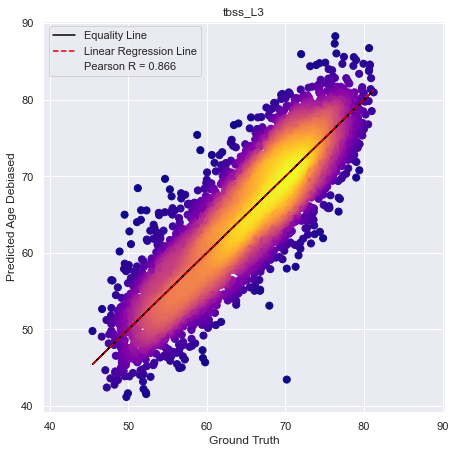

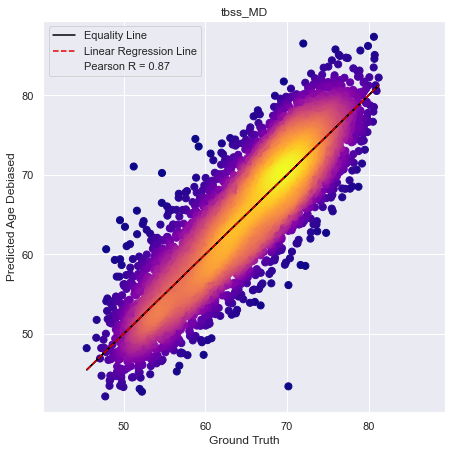

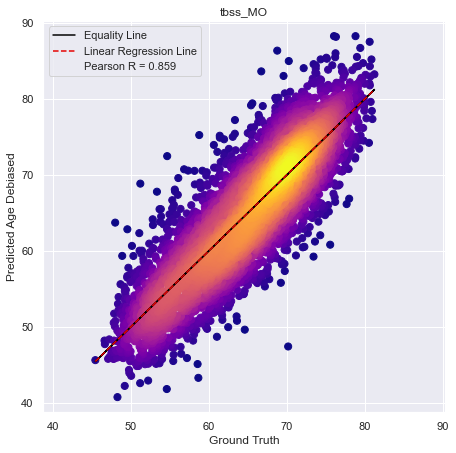

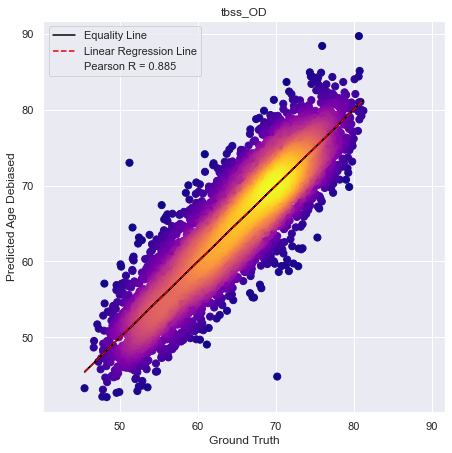

In [11]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.output_age_decon, xlabel='Ground Truth', 
                               ylabel='Predicted Age Debiased', title=name_mod, set_scale=True,
                              deconfound=False, subjects=df_mod['Unnamed: 0'].to_numpy())

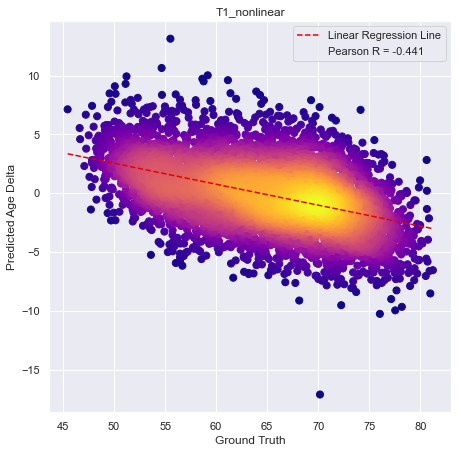

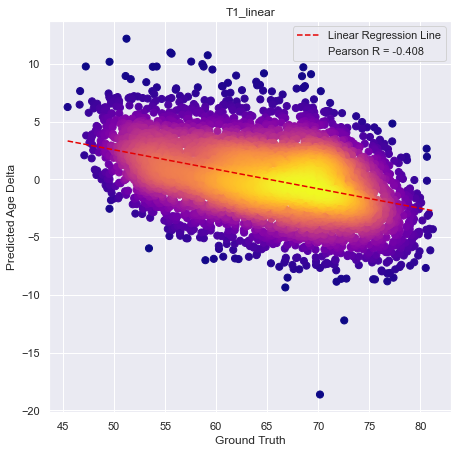

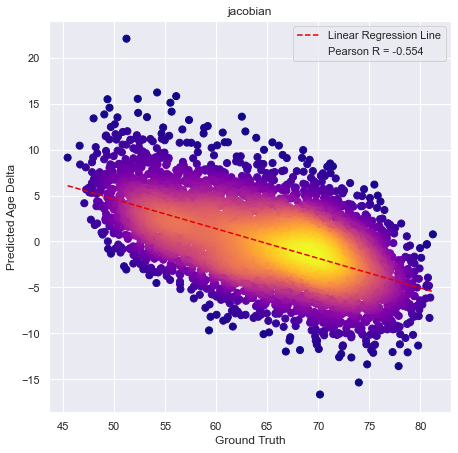

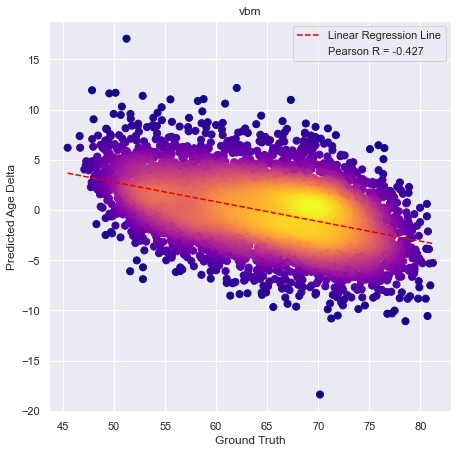

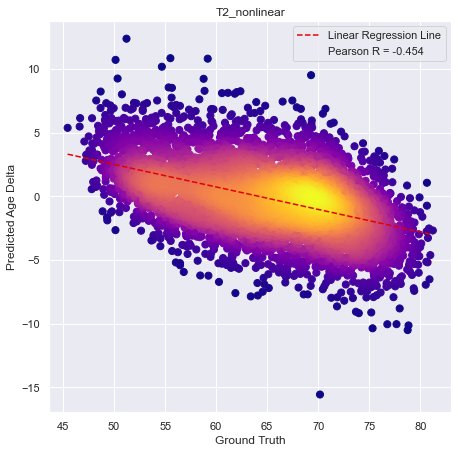

...

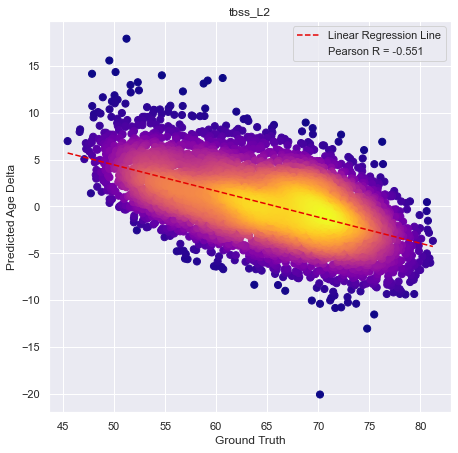

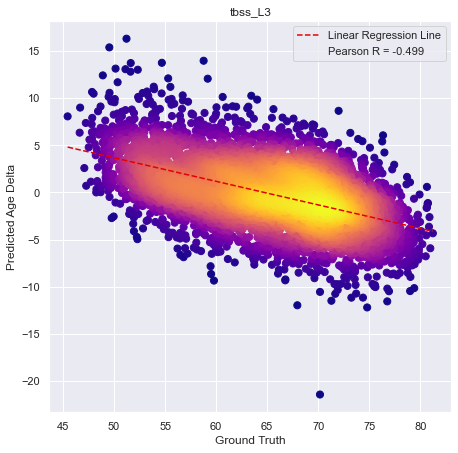

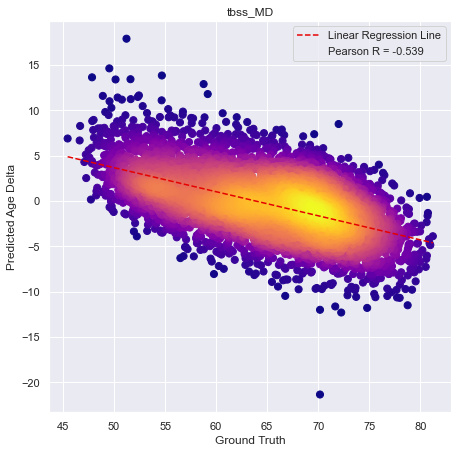

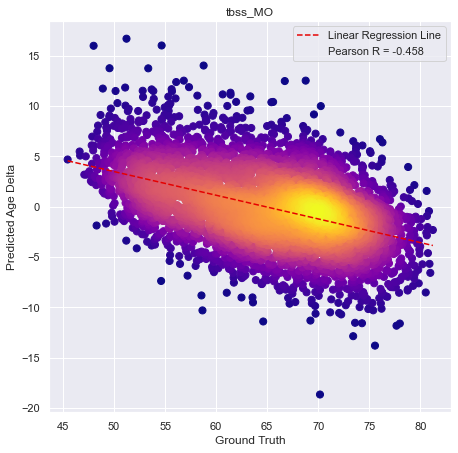

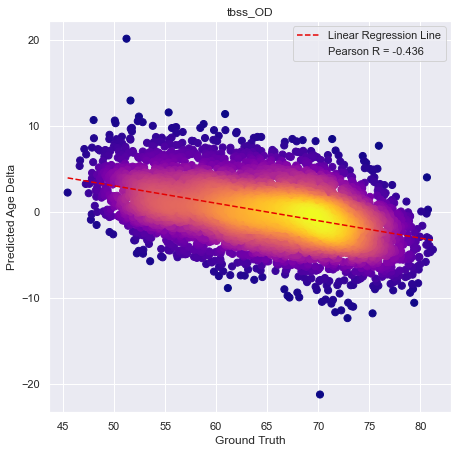

In [12]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.mean_age_delta, xlabel='Ground Truth', 
                               ylabel='Predicted Age Delta', title=name_mod, set_scale=False, 
                               equality_line=False, deconfound=False, subjects=df_mod['Unnamed: 0'].to_numpy())

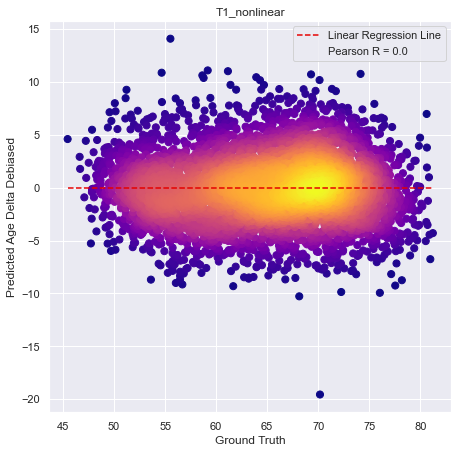

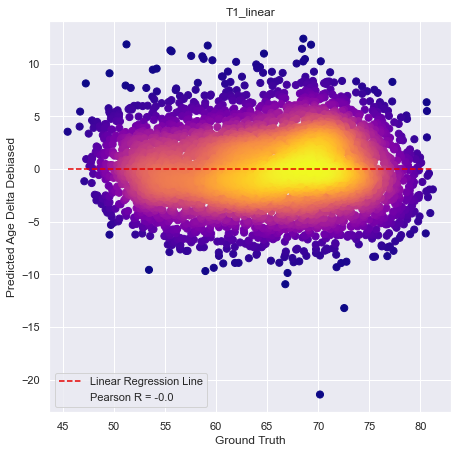

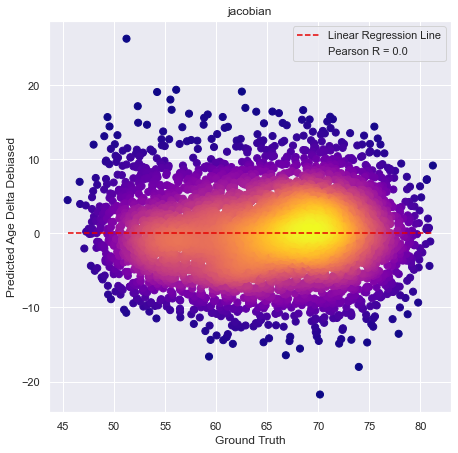

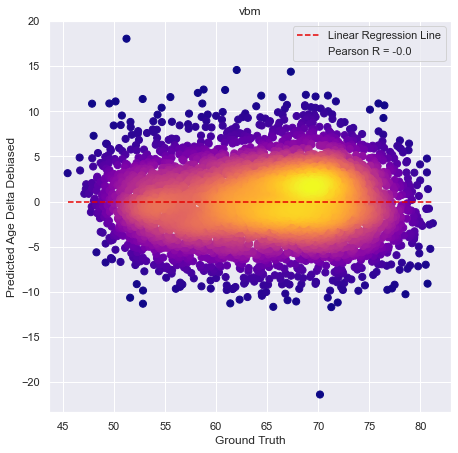

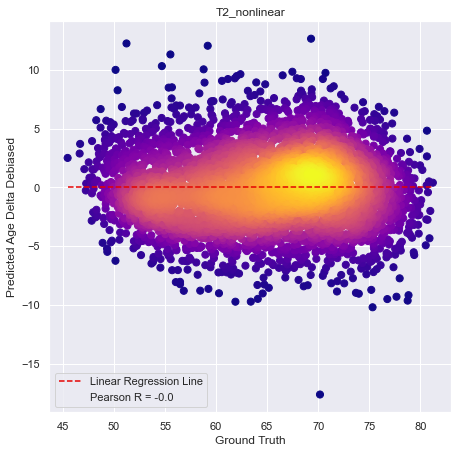

...

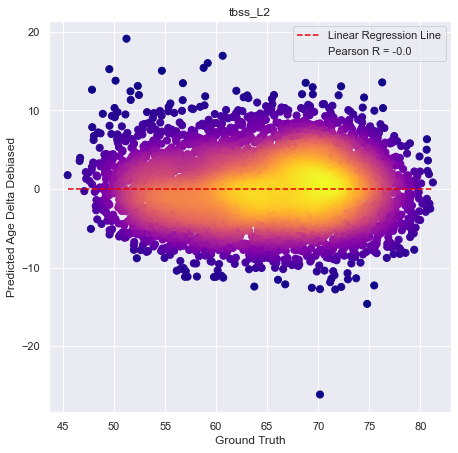

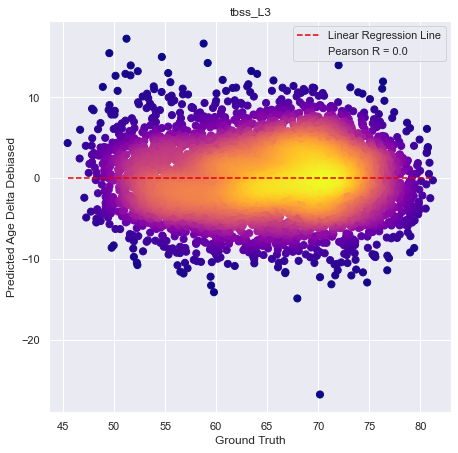

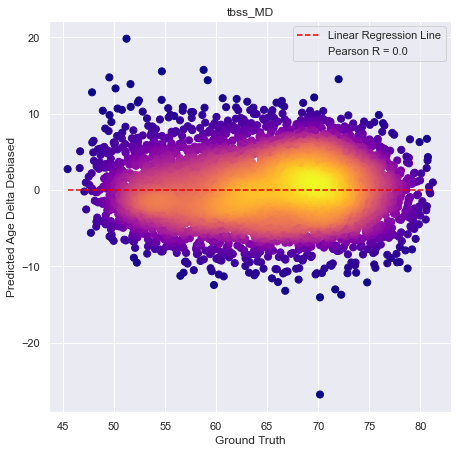

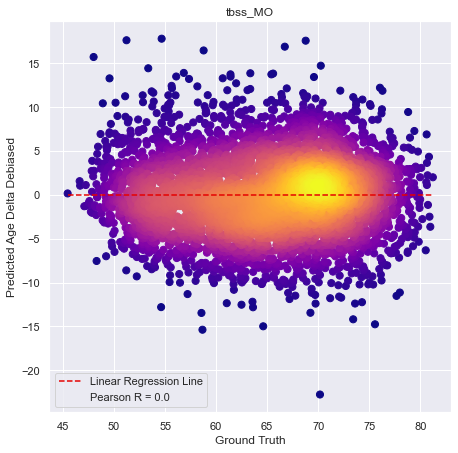

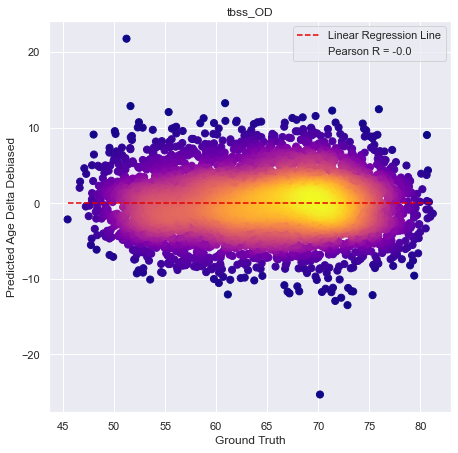

In [13]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.age_delta_decon, xlabel='Ground Truth', 
                               ylabel='Predicted Age Delta Debiased', title=name_mod, set_scale=False, 
                               equality_line=False, deconfound=False, subjects=df_mod['Unnamed: 0'].to_numpy())

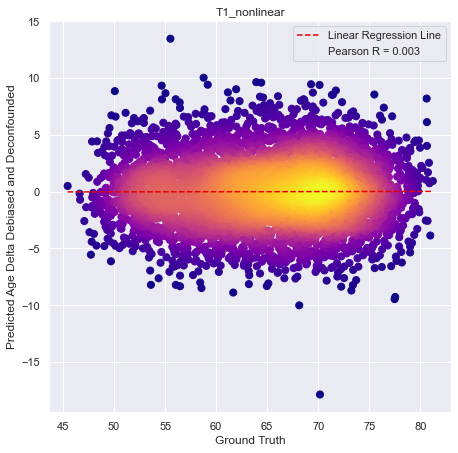

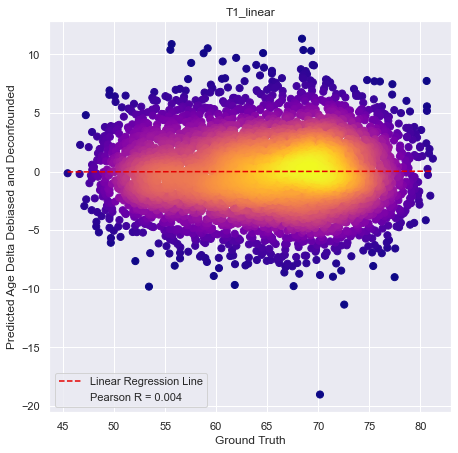

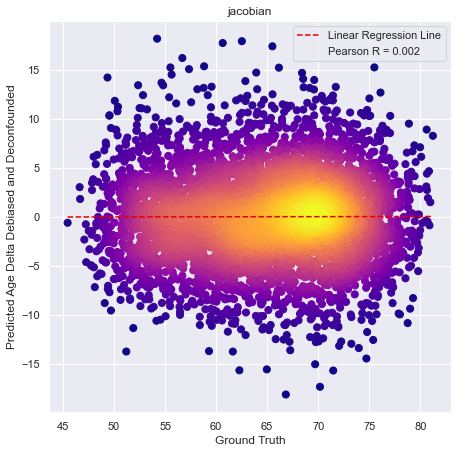

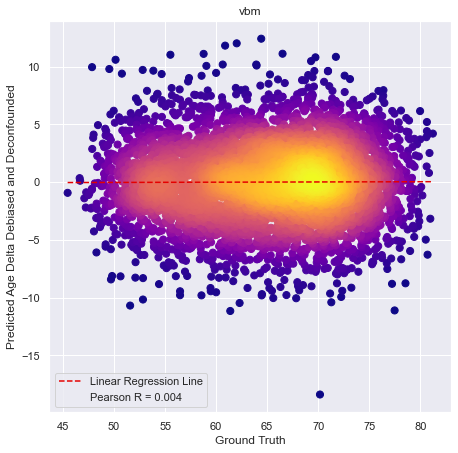

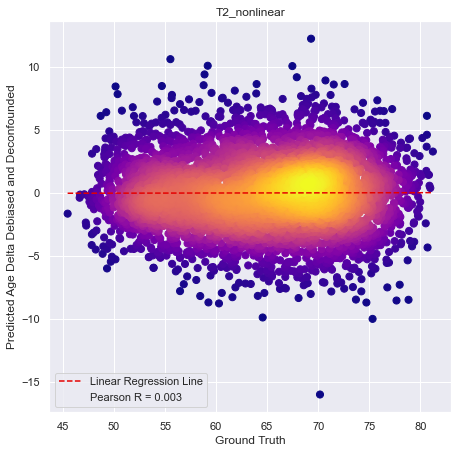

...

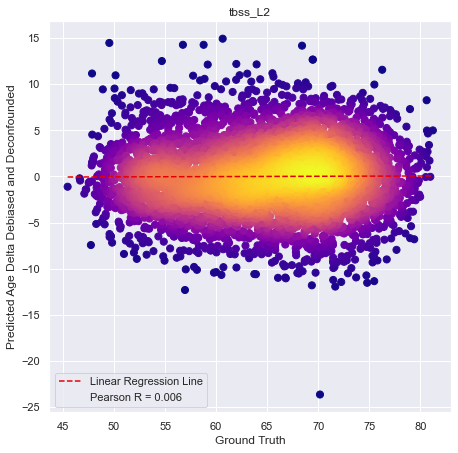

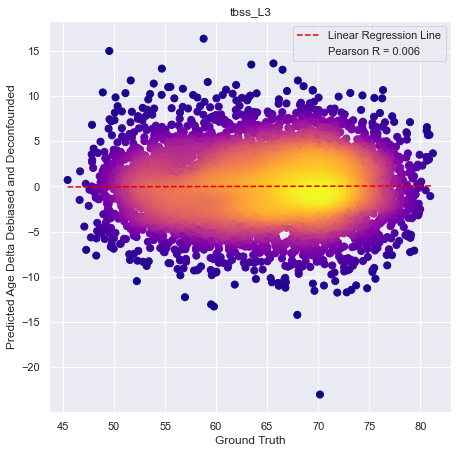

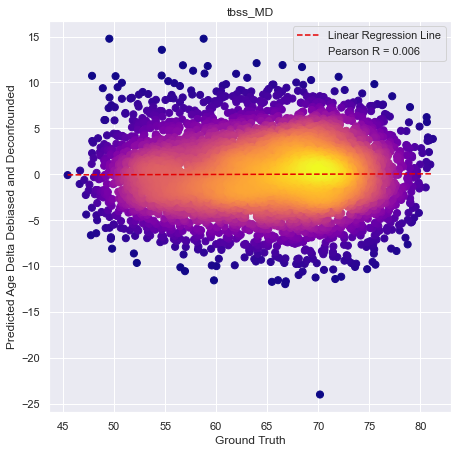

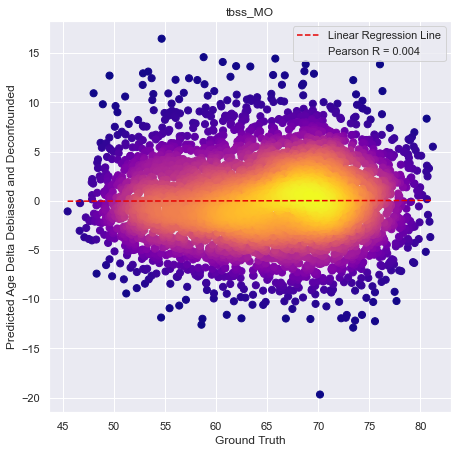

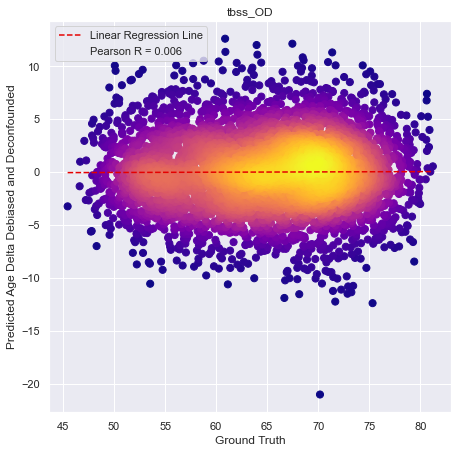

In [14]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.age_delta_decon, xlabel='Ground Truth', 
                               ylabel='Predicted Age Delta Debiased', title=name_mod, set_scale=False, 
                               equality_line=False, deconfound=True, subjects=df_mod['Unnamed: 0'].to_numpy())

<ipython-input-6-d84b9470e0f6>:216: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


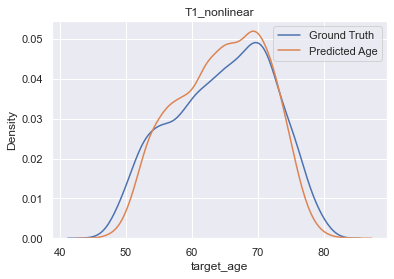

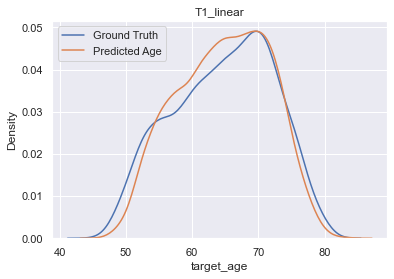

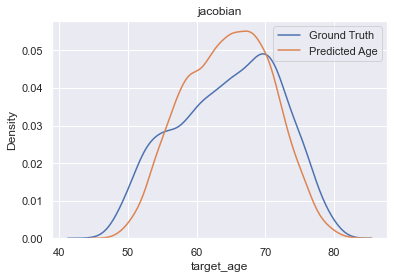

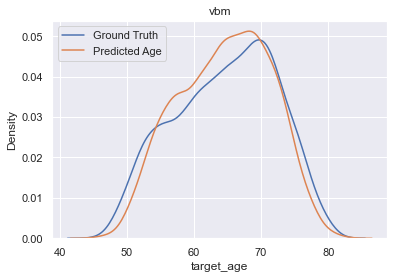

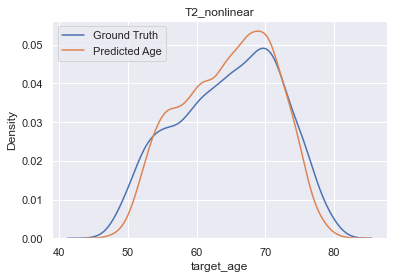

...

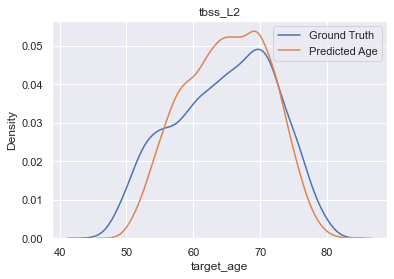

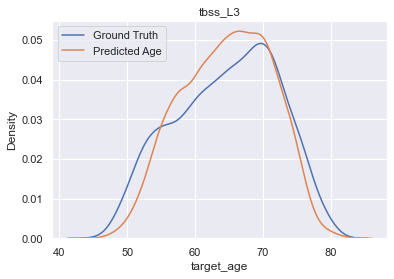

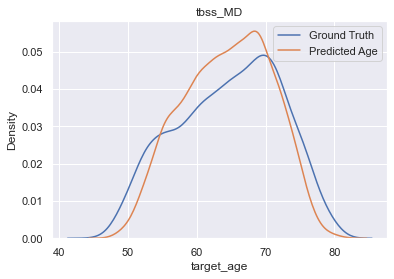

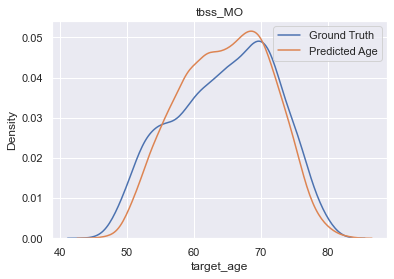

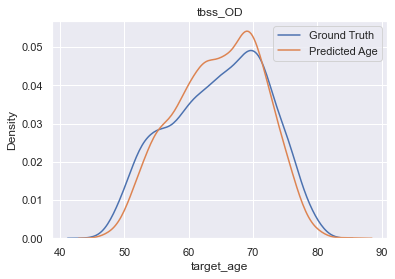

In [15]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = kde_plot(x=df_mod.target_age, y=df_mod.mean_output_age, 
                   xlabel='Ground Truth', ylabel='Predicted Age',
                   title=name_mod)

<ipython-input-6-d84b9470e0f6>:216: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


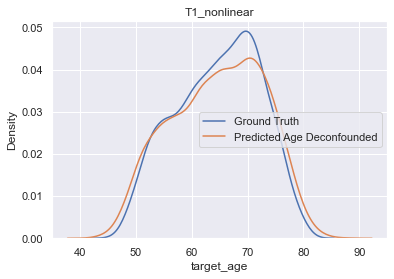

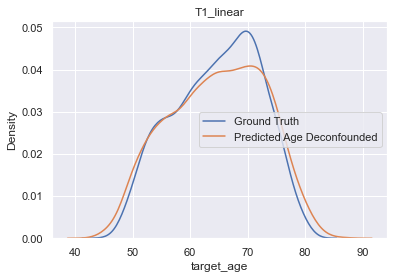

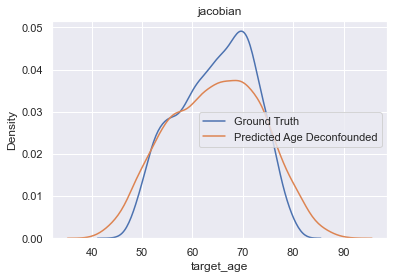

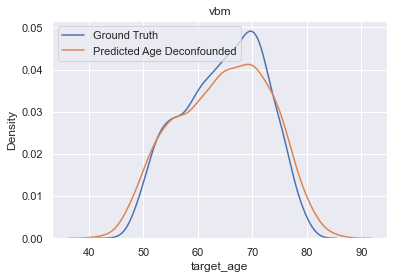

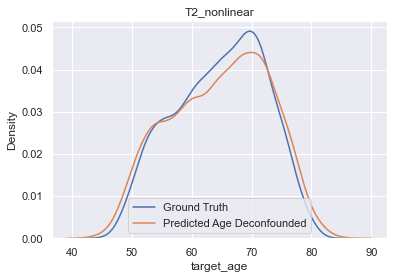

...

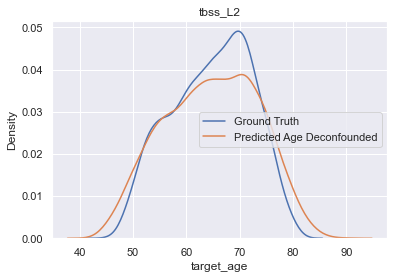

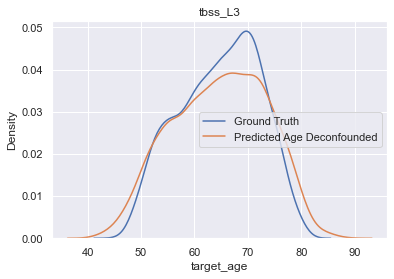

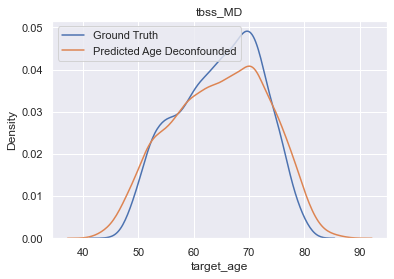

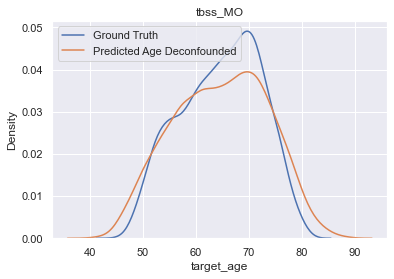

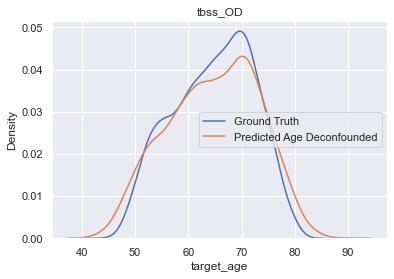

In [16]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = kde_plot(x=df_mod.target_age, y=df_mod.output_age_decon, 
                   xlabel='Ground Truth', ylabel='Predicted Age Deconfounded',
                   title=name_mod)

In [17]:
# if deconfound_flag == True:
#     eng.quit()

In [4]:
def scatter_plot_heatmap_subplots(ax, x, y, xlabel, ylabel, title, equality_line=True, set_scale=False,
                                 set_y_scale=None, set_hard_scale=None, 
                                  title_font_size=15, x_axis_off_flag=False, y_axis_off_flag=False,
                                  ticks_font_size=12,
                                  plot_legend_flag = True, legend_font = 12, plot_full_legend=True,
                                  text_x=40, text_y=40,
                                 ):
    
    x = x.to_numpy()
    y = y.to_numpy()
    
    sns.set_style("darkgrid", {'image.cmap': u'plasma'})
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    # Sort the points by density, so that the densest points are plotted last
    srt = z.argsort()
    x, y, z = x[srt], y[srt], z[srt]
    ax.scatter(x,y,c=z,s=50)
    if equality_line == True:
        if plot_full_legend==True:
            ax.plot(x, x, ls="-", color = sns.xkcd_rgb['black'], label='Equality Line') #this is just the line of equality
        else:
            ax.plot(x, x, ls="-", color = sns.xkcd_rgb['black']) #this is just the line of equality


    X_mat=np.vstack((np.ones(len(x)), x)).T
    beta_hat = np.linalg.inv(X_mat.T.dot(X_mat)).dot(X_mat.T).dot(y)
    b,w = beta_hat[0],beta_hat[1]
    x2 = np.linspace(np.min(x),np.max(x),num=10)
    y2 = w * x2 + b
    if plot_full_legend==True:
        ax.plot(x2,y2,ls='--', color= sns.xkcd_rgb['red'], label='Linear Regression Line')
    else:
        ax.plot(x2,y2,ls='--', color= sns.xkcd_rgb['red'])
    
    pearson_correlation = pearsonr(x,y)[0]
    
    if set_scale == True:
        x_min, x_max = np.min(x), np.max(x)
        y_min, y_max = np.min(y), np.max(y)
        c_min, c_max = min(x_min, y_min), max(x_max, y_max)
        ax.set_xlim([c_min-2, c_max+2])
        ax.set_ylim([c_min-2, c_max+2])
        
    if set_y_scale != None:
        ax.set_ylim([-set_y_scale-2, set_y_scale+2])
        
    if set_hard_scale!=None:
        ax.set_xlim([set_hard_scale[0]-2, set_hard_scale[1]+2])
        ax.set_ylim([set_hard_scale[2]-2, set_hard_scale[3]+2])
    
    ax.set_xlabel(xlabel,  fontsize=title_font_size)
    ax.set_ylabel(ylabel,  fontsize=title_font_size)
    
    ax.tick_params(axis='x', labelsize= ticks_font_size)
    ax.tick_params(axis='y', labelsize= ticks_font_size)
    
    lbl = 'Pearson R = '+str(round(pearson_correlation,3))
#     ax.plot([],[],' ',label=lbl)
    ax.text(text_x, text_y, lbl, fontsize=legend_font)
    
    ax.set_title(title, fontsize=title_font_size)
    if plot_legend_flag == True:
        ax.legend(fontsize=legend_font, loc=2)
    
    if x_axis_off_flag == True:
        ax.axes.xaxis.set_ticklabels([])
    if y_axis_off_flag == True:
        ax.axes.yaxis.set_ticklabels([])

In [5]:
def kde_subplot(ax, x, y, xlegend=None, ylegend=None, xlabel=None, ylabel=None, title=None,
               title_font_size=15, x_axis_off_flag=False, y_axis_off_flag=False, set_hard_scale=None,
                ticks_font_size=12, 
                plot_legend_flag = True, legend_font = 12,
               ):
    
    if ylegend == None:
        ylegend = ['Predicted Brain Ages', 'Debiased Predicted Brain Ages']
    
    ax.tick_params(axis='x', labelsize= ticks_font_size)
    ax.tick_params(axis='y', labelsize= ticks_font_size)
    
    sns.kdeplot(x, ax=ax, label= xlegend, color = sns.xkcd_rgb['black'], linewidth = 2)
    if isinstance(y, list):
        for i, ys in enumerate(y):
            sns.kdeplot(ys, ax=ax, label= ylegend[i], linewidth = 2)
    else:
        sns.kdeplot(y, ax=ax, label= ylegend)
    ax.set_xlabel(xlabel,  fontsize=15)
    ax.set_ylabel(ylabel,  fontsize=title_font_size)
    ax.set_title(title, fontsize=title_font_size)
    if plot_legend_flag == True:
        ax.legend(fontsize=legend_font, loc=2)
    if x_axis_off_flag == True:
        ax.axes.xaxis.set_ticklabels([])
    if y_axis_off_flag == True:
        ax.axes.yaxis.set_ticklabels([])
    if set_hard_scale!=None:
        ax.set_xlim([set_hard_scale[0]-2, set_hard_scale[1]+2])
        ax.set_ylim([set_hard_scale[2]-0.001, set_hard_scale[3]+0.001])

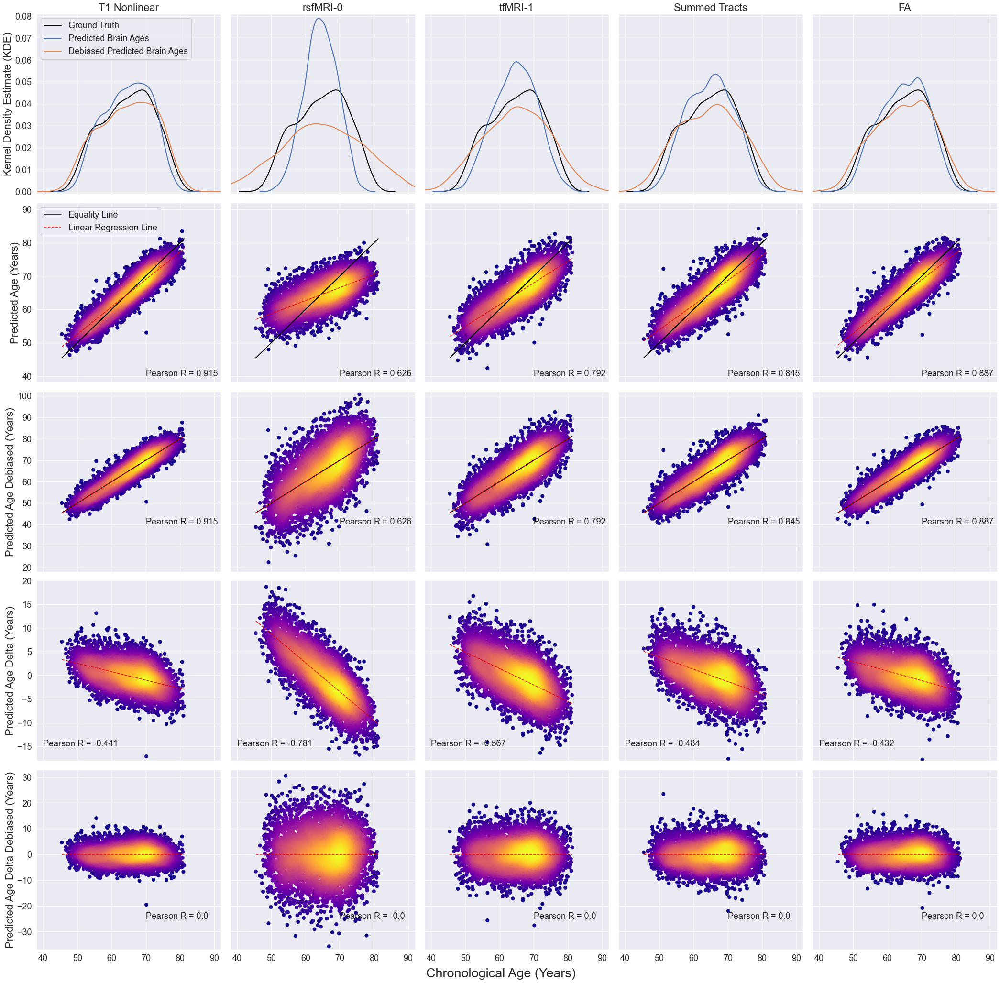

In [11]:
titles = [
    'T1 Nonlinear', 'rsfMRI-0', 'tfMRI-1', 'Summed Tracts', 'FA'
        ]

modality_indexes = [0, 7, 32, 38, 48]

ncols=5
nrows=5
sz=7.2
title_font_size=22
ticks_font_size=18
legend_font = 18

fig, axes = plt.subplots(ncols=ncols,nrows=nrows,figsize=(ncols*sz,nrows*sz))

axes = axes.ravel()

i = 0

for idx in modality_indexes:
    df_mod = dfB.iloc[idx].dataframe
    name_mod = dfB.iloc[idx].modality
    if idx == 0:
        ylabel = 'Kernel Density Estimate (KDE)'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = True
        plot_full_legend=True
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    
    kde_subplot(ax=axes[i], x=df_mod.target_age, y=[df_mod.mean_output_age, df_mod.output_age_decon],
                xlegend='Ground Truth', 
                xlabel=None, ylabel=ylabel, title=titles[i],
                set_hard_scale = [40,90,0,0.08],
               title_font_size=title_font_size,
               x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                ticks_font_size = ticks_font_size,
                plot_legend_flag=plot_legend_flag, legend_font=legend_font
               )
    i+=1

    

for idx in modality_indexes:
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age (Years)'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = True
        plot_full_legend=True
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.mean_output_age, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=True,
                                  title_font_size=title_font_size, 
                                  set_hard_scale = [40,90,40,90],
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = plot_legend_flag, legend_font = legend_font, 
                                  plot_full_legend=plot_full_legend,
                                  text_x=70, text_y=40,
                                 )
    i+=1


for idx in modality_indexes:
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age Debiased (Years)'
        x_axis_off_flag=True
        y_axis_off_flag=False
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.output_age_decon, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False,
                                        set_hard_scale = [40,90,20,100],
                                  title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = False, legend_font = legend_font,
                                  text_x=70, text_y=40,
                                 )
    i+=1

    
for idx in modality_indexes:
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age Delta (Years)'
        x_axis_off_flag=True
        y_axis_off_flag=False
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.mean_age_delta, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False, equality_line=False, 
#                                   set_y_scale=14,
                                  set_hard_scale = [40,90,-16,18],
                                 title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = False, legend_font = legend_font,
                                  text_x=40, text_y=-15,
                                 )
    i+=1

        
    

for idx in modality_indexes:
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age Delta Debiased (Years)'
        x_axis_off_flag=False
        y_axis_off_flag=False
    else:
        ylabel = None
        x_axis_off_flag=False
        y_axis_off_flag=True
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.age_delta_decon, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False, equality_line=False, 
#                                   set_y_scale=21,
                                  set_hard_scale = [40,90,-35,31],
                                  title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = False, legend_font = legend_font, 
                                  text_x=70, text_y=-25,
                                 )
    i+=1

    


fig.subplots_adjust(wspace=0.05, hspace=0.05)
fig.supxlabel('Chronological Age (Years)', y=0.11, fontsize=title_font_size+5, verticalalignment='top')
    
# # handles, labels = axes.get_legend_handles_labels()
# # fig.legend(handles, labels, loc='upper center')
# # plt.figlegend( lines, labels, loc = 'lower center', ncol=5, labelspacing=0. )
# # lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
# # lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
# # fig.legend(lines, labels)
    
fig.savefig('Male_Scatter_Plots_FULL.png', bbox_inches='tight')
    